In [2]:
import pandas as pd
import numpy as np
import scipy as sp
from plotly.offline import iplot
import plotly.figure_factory as ff
import pandas as pd
import plotly.graph_objects as go

import pandas as pd

mapbox_access_token = 'pk.eyJ1IjoiZ2hjYXJuZWlybyIsImEiOiJjazBmOXNjNmswcWcyM2JxZXhjNzc2eDBkIn0.L4pHZaHSpa4pQL-fML9i5w'

df = pd.read_csv('measurements (2-1).csv')

df

,locationId,location,city,country,utc,local,parameter,value,unit,latitude,longitude
0,10584,Footscray,Melbourne,AU,2020-04-30T14:00:00+00:00,2020-05-01T00:00:00+10:00,pm10,3.1,µg/m³,-37.803707,144.869339
1,6455,Wynnum,South East Queensland,AU,2020-04-30T14:00:00+00:00,2020-05-01T00:00:00+10:00,pm10,10.5,µg/m³,-27.429600,153.158000
2,7693,Dallas,Melbourne,AU,2020-04-30T14:00:00+00:00,2020-05-01T00:00:00+10:00,pm10,1.8,µg/m³,-37.669450,144.944400
3,10868,Dandenong,Melbourne,AU,2020-04-30T14:00:00+00:00,2020-05-01T00:00:00+10:00,pm10,2.8,µg/m³,-37.985760,145.198700
4,6472,Coastguard,Townsville,AU,2020-04-30T14:00:00+00:00,2020-05-01T00:00:00+10:00,pm10,8.7,µg/m³,-19.252600,146.827000
...,...,...,...,...,...,...,...,...,...,...,...
75166,7666,Port Augusta,Port Augusta,AU,2020-03-17T13:30:00+00:00,2020-03-18T00:00:00+10:30,pm10,25.5,µg/m³,-32.510007,137.786847
75167,10477,Le Fevre 1,Adelaide,AU,2020-03-17T13:30:00+00:00,2020-03-18T00:00:00+10:30,pm10,47.0,µg/m³,-34.838669,138.496348
75168,10483,Whyalla Walls St,Whyalla,AU,2020-03-17T13:30:00+00:00,2020-03-18T00:00:00+10:30,pm10,77.3,µg/m³,-33.036116,137.586098
75169,10478,Netley,Adelaide,AU,2020-03-17T13:30:00+00:00,2020-03-18T00:00:00+10:30,pm10,23.0,µg/m³,-34.943804,138.549098


In [3]:
import plotly.express as px
#using mapbox access token provided in tutorial, it's not stealing if it's public 
px.set_mapbox_access_token("pk.eyJ1IjoiZ2hjYXJuZWlybyIsImEiOiJjazBmOXNjNmswcWcyM2JxZXhjNzc2eDBkIn0.L4pHZaHSpa4pQL-fML9i5w")

#replacing the "local" column with the first 10 characters of utc as I already have one time column and this can serve as an
#animation frame timeline
df = df[::-1]
df['local'] = df['utc'].str[:10]

fig = px.scatter_mapbox(df,
                        title='Air quality in pm10 over time of Australia (excluding WA,TAS and NT)',
                        lat="latitude", 
                        lon="longitude",     
                        color="value",
                        range_color = [0,150],
                        size = "value",
                        hover_name='location',
                        hover_data = ['city', 'value'],
                        animation_frame = 'local',
                        category_orders={"local": df.local},
                        zoom = 2.5)
fig.show()

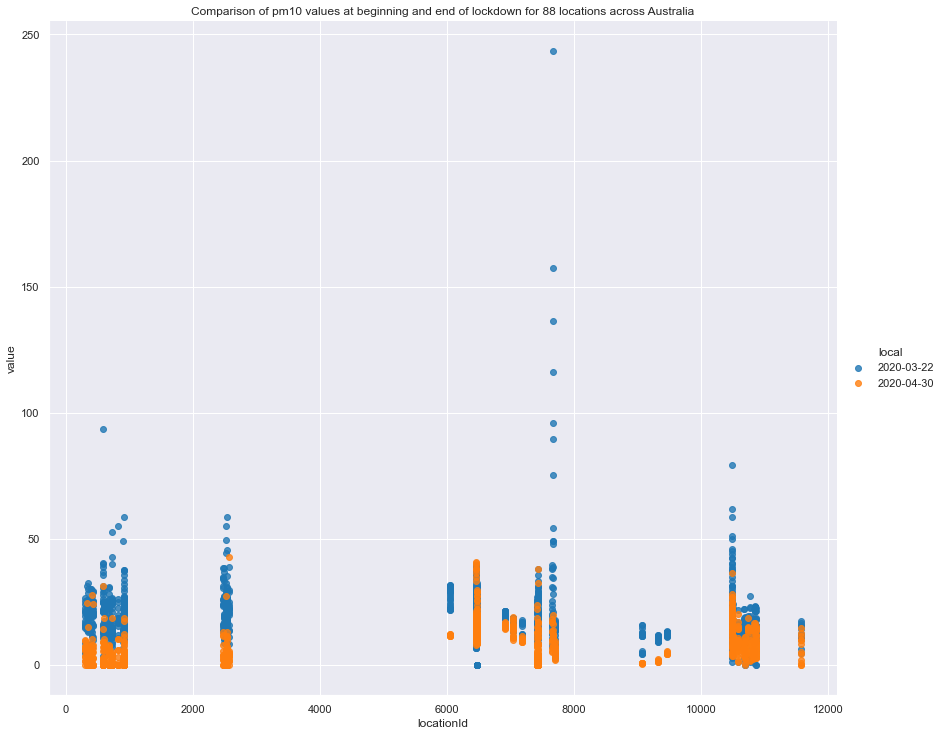

In [4]:
import seaborn as sns
sns.set(font_scale=1, palette = "tab10")
sns.lmplot(x='locationId', y='value', hue='local', height=10, aspect=1.17,
           data=df.loc[df['local'].isin(['2020-04-30', '2020-03-22'])],
           fit_reg=False
          ).set(title = "Comparison of pm10 values at beginning and end of lockdown for 88 locations across Australia")

In [5]:
past = df[df.local == "2020-03-24"]
later = df[df.local == "2020-04-30"]

In [21]:
later.groupby(['locationId'],as_index=False)['value'].mean()

,locationId,value
0,304,5.066667
1,336,5.308333
2,355,4.627273
3,398,2.116667
4,417,5.233333
...,...,...
83,10826,8.460000
84,10843,14.100000
85,10868,8.606667
86,10869,7.860000


In [22]:
past.groupby(['locationId'],as_index=False)['value'].mean()

,locationId,value
0,304,17.794737
1,336,15.868421
2,355,17.352632
3,398,17.078947
4,417,14.968421
...,...,...
83,10826,12.183333
84,10843,30.966667
85,10868,15.450000
86,10869,15.525000


In [26]:
differences = later.groupby(['locationId'])['value'].mean()/past.groupby(['locationId'])['value'].mean()
differences

locationId
304      0.284728
336      0.334522
355      0.266661
398      0.123934
417      0.349625
           ...   
10826    0.694391
10843    0.455328
10868    0.557066
10869    0.506280
11566    1.530359
Name: value, Length: 88, dtype: float64

In [27]:
from statsmodels.stats import weightstats as stest
pvalue = stest.ztest(differences,value = 1, alternative = "smaller")
1-pvalue[1]

0.9999999999991611

In [29]:
import statsmodels.stats.api as sms

sms.DescrStatsW(differences).tconfint_mean(alpha=0.01, alternative='two-sided')


(0.51137003617398, 0.7769001428397081)

In [11]:
copy = df
john = copy.groupby(["location","local"],as_index=False).mean() #latitude and longitude are unaffected by the mean as 
#they remain the same for each location
john

,location,local,locationId,value,latitude,longitude
0,Albion Park Sth,2020-03-17,592,15.233333,-34.580556,150.781667
1,Albion Park Sth,2020-03-18,592,30.073684,-34.580556,150.781667
2,Albion Park Sth,2020-03-19,592,38.931250,-34.580556,150.781667
3,Albion Park Sth,2020-03-20,592,24.435714,-34.580556,150.781667
4,Albion Park Sth,2020-03-21,592,15.976471,-34.580556,150.781667
...,...,...,...,...,...,...
3933,Yinnar,2020-04-26,10819,19.000000,-38.326760,146.326000
3934,Yinnar,2020-04-27,10819,19.069565,-38.326760,146.326000
3935,Yinnar,2020-04-28,10819,20.484615,-38.326760,146.326000
3936,Yinnar,2020-04-29,10819,10.382353,-38.326760,146.326000


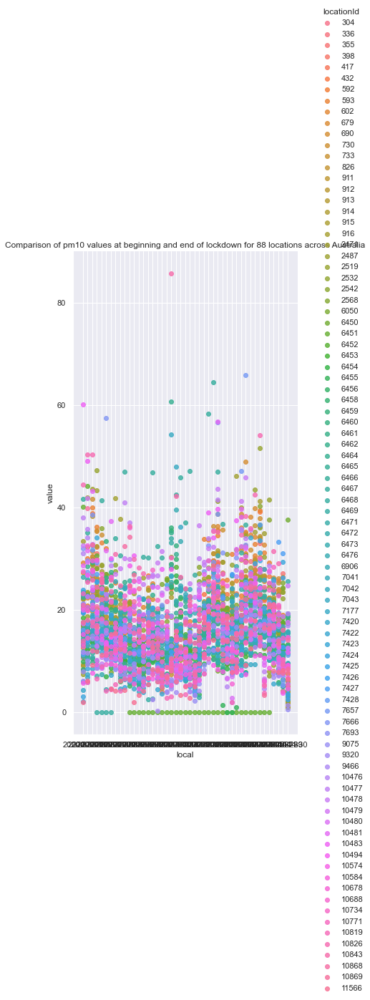

In [12]:
import seaborn as sns
sns.set(font_scale=1, palette = "tab10")
sns.lmplot(x='local', y='value', hue='locationId', height=10, aspect=0.5,
           data=john,
           fit_reg=False
          ).set(title = "Comparison of pm10 values at beginning and end of lockdown for 88 locations across Australia")

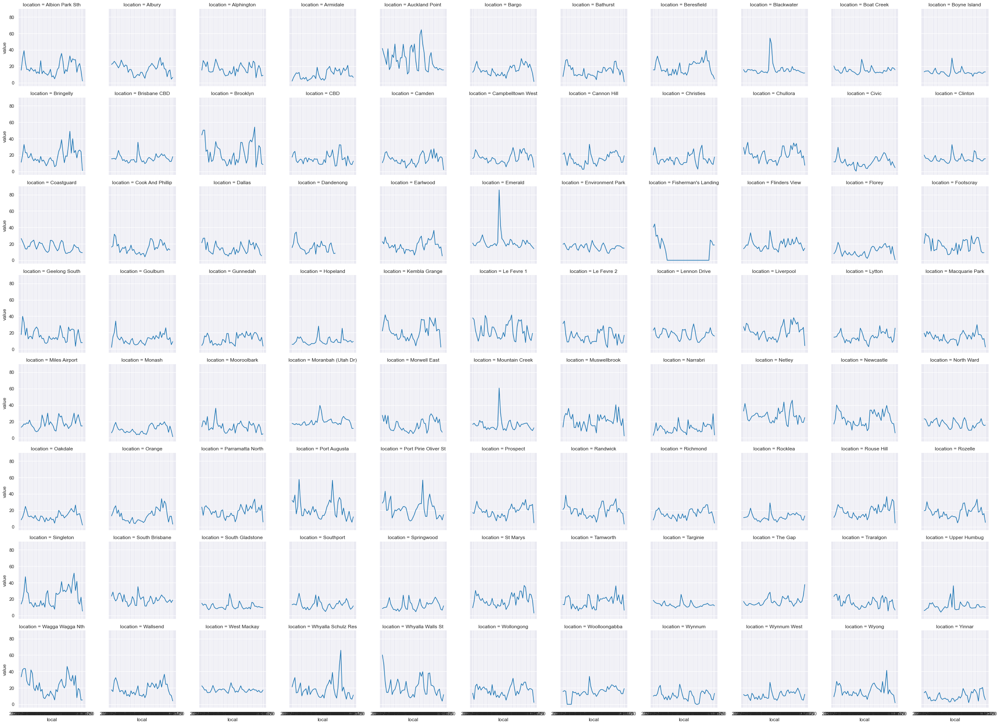

In [13]:
g = sns.FacetGrid(john, col = 'location', col_wrap = 11)

g.map(sns.lineplot, "local","value")

In [14]:
fig = px.scatter_mapbox(john,
                        title='Air quality in pm10 over time of Australia (excluding WA,TAS and NT)',
                        lat="latitude", 
                        lon="longitude",     
                        color="value",
                        range_color = [0,90],
                        size = "value",
                        hover_name='location',
                        hover_data = ['value'],
                        animation_frame = 'local',
                        category_orders={"local": john.local},
                        zoom = 2.5)
fig.show()

AttributeError: module 'matplotlib' has no attribute 'scatter'

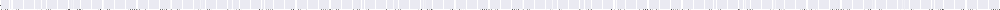

In [15]:
import matplotlib as plt
h = sns.FacetGrid(john, col="location", margin_titles=True, height=4)
h.map(plt.scatter, "local", "value", color="#338844", edgecolor="white", s=50, lw=1)

In [ ]:
for i in 